In [1]:
import pandas as pd
import numpy as np
import os
import wrangle
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
#sklearn stuff 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from scipy import stats
import utilities
import warnings
warnings.filterwarnings("ignore")


- What groups are most likely to be attacked
- What groups are most active
- What are the most common methods of attack 
- What locations are most prone to being attacked
- Are any certain terrorist groups gaining momentum/ falling off
- Can it be told when there is a “power vacuum” that is opening up
- Has the methodology of attacks changed as time progressed?
- Are property structures being targeted as a way to cause more damage?
- How successful are the attacks?
- What groups are most likely to launch suicide attacks?
- What nationalities are most at risk?
- How has the frequency of attacks changed over the years?

- relationship between type of attack and number wounded
- relationship between group and success
- relationship between type of attack and success
- relationship between day and type of attack

Initial Hypotheses: 
- Terrorism has changed over time and the fall of some terrorist groups will leave room for other terrorist groups grasping for power. 
- Certain groups are more likely to be targeted than others. 
- There is a possible relationship between when structures are being targeted and high casualty rates. 
- capital/ major cities are much more likely to be attacked than other areas. 
- The way that terrorist attack has changed over time, i.e. there has probably been a change from using things like guns to other methods like explosives/ ieds. 
- Terrorist groups have grown to be more violent as time has progressed. 

In [2]:
df = wrangle.get_terrorism_data()

In [3]:
df = wrangle.prep_df(df)

## Has the number of terrorist attacks changed over the years?

In [4]:
px.histogram(df, x = 'year')

- a quick visualization shows us that the number of attacks increased drastically from 2010 to 2014, but the number seemed to decline some after 2014

# How has the activity of major terrorist groups changed over time?

In [5]:
# split my data into train, validate, and test subsets. 
train, validate, test = wrangle.split_data(df)

In [6]:
# create a df of the top 20 groups with their number of attacks
top_groups = pd.DataFrame(train.atk_group.value_counts().head(20))

In [7]:
# create a list of the top 20 groups
top_list= list(top_groups.index)

In [8]:
top_list

['unknown',
 'taliban',
 'islamic state of iraq and the levant (isil)',
 'al-shabaab',
 "kurdistan workers' party (pkk)",
 'tehrik-i-taliban pakistan (ttp)',
 'al-qaida in iraq',
 'sinai province of the islamic state',
 'khorasan chapter of the islamic state',
 'baloch republican army (bra)',
 'muslim extremists',
 'baloch liberation front (blf)',
 'baloch liberation army (bla)',
 'al-nusrah front',
 'lashkar-e-jhangvi',
 'janjaweed',
 'hamas (islamic resistance movement)',
 'houthi extremists (ansar allah)',
 'gunmen',
 'free syrian army']

In [9]:
# create a new df of the top 20 groups that contains all the info of the original df
df_top = train[train['atk_group'].isin(top_list)]

In [10]:
df_top

,eventid,year,month,day,country,region,provstate,city,latitude,longitude,...,claimed,weap_type,weap_sub,killed,us_killed,ter_killed,wounded,us_wounded,ter_wounded,property
47718,201511290012,2015,11,29,afghanistan,south asia,kabul,kabul,34.516895,69.147011,...,0.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,0
19456,201207140007,2012,7,14,afghanistan,south asia,kandahar,kandahar,31.631083,65.742226,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,1
25865,201307240011,2013,7,24,iraq,middle east & north africa,saladin,sulayman beg,34.790665,44.662151,...,0.0,explosives,"projectile (rockets, mortars, rpgs, etc.)",0.0,0.0,0.0,1.0,0.0,0.0,-9
22699,201302190017,2013,2,19,somalia,sub-saharan africa,banaadir,mogadishu,2.059819,45.326115,...,0.0,explosives,grenade,3.0,0.0,0.0,6.0,0.0,0.0,0
19572,201207220002,2012,7,21,egypt,middle east & north africa,north sinai,arish,31.126646,33.800865,...,0.0,explosives,remote trigger,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51373,201605140010,2016,5,14,iraq,middle east & north africa,diyala,madain,33.100529,44.584492,...,0.0,explosives,unknown explosive type,2.0,0.0,0.0,7.0,0.0,0.0,-9
41422,201502280009,2015,2,27,afghanistan,south asia,nangarhar,kama district,34.418080,70.649529,...,0.0,explosives,vehicle,3.0,0.0,1.0,13.0,0.0,0.0,1
58151,201703270003,2017,3,27,sudan,sub-saharan africa,north darfur,el fashir district,13.579714,25.032026,...,0.0,firearms,automatic or semi-automatic rifle,0.0,0.0,0.0,0.0,0.0,0.0,1
36867,201408180024,2014,8,18,egypt,middle east & north africa,gharbia,as santah,30.747309,31.130546,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,1.0,0.0,0.0,0


In [11]:
df_top.atk_group.value_counts()

unknown                                        15419
taliban                                         2687
islamic state of iraq and the levant (isil)     2117
al-shabaab                                       864
kurdistan workers' party (pkk)                   534
tehrik-i-taliban pakistan (ttp)                  496
al-qaida in iraq                                 287
sinai province of the islamic state              203
khorasan chapter of the islamic state            150
baloch republican army (bra)                     146
muslim extremists                                 97
baloch liberation front (blf)                     87
baloch liberation army (bla)                      83
al-nusrah front                                   79
lashkar-e-jhangvi                                 66
janjaweed                                         63
hamas (islamic resistance movement)               61
houthi extremists (ansar allah)                   60
gunmen                                        

## a lot of the attacks aren't attributed to any particular group. 

In [12]:
df_top

,eventid,year,month,day,country,region,provstate,city,latitude,longitude,...,claimed,weap_type,weap_sub,killed,us_killed,ter_killed,wounded,us_wounded,ter_wounded,property
47718,201511290012,2015,11,29,afghanistan,south asia,kabul,kabul,34.516895,69.147011,...,0.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,0
19456,201207140007,2012,7,14,afghanistan,south asia,kandahar,kandahar,31.631083,65.742226,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,1
25865,201307240011,2013,7,24,iraq,middle east & north africa,saladin,sulayman beg,34.790665,44.662151,...,0.0,explosives,"projectile (rockets, mortars, rpgs, etc.)",0.0,0.0,0.0,1.0,0.0,0.0,-9
22699,201302190017,2013,2,19,somalia,sub-saharan africa,banaadir,mogadishu,2.059819,45.326115,...,0.0,explosives,grenade,3.0,0.0,0.0,6.0,0.0,0.0,0
19572,201207220002,2012,7,21,egypt,middle east & north africa,north sinai,arish,31.126646,33.800865,...,0.0,explosives,remote trigger,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51373,201605140010,2016,5,14,iraq,middle east & north africa,diyala,madain,33.100529,44.584492,...,0.0,explosives,unknown explosive type,2.0,0.0,0.0,7.0,0.0,0.0,-9
41422,201502280009,2015,2,27,afghanistan,south asia,nangarhar,kama district,34.418080,70.649529,...,0.0,explosives,vehicle,3.0,0.0,1.0,13.0,0.0,0.0,1
58151,201703270003,2017,3,27,sudan,sub-saharan africa,north darfur,el fashir district,13.579714,25.032026,...,0.0,firearms,automatic or semi-automatic rifle,0.0,0.0,0.0,0.0,0.0,0.0,1
36867,201408180024,2014,8,18,egypt,middle east & north africa,gharbia,as santah,30.747309,31.130546,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,1.0,0.0,0.0,0


In [13]:
df_top= df_top.sort_values('year')

In [14]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    df_top, 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,21],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 3000

fig.show()

In [15]:
df_top.shape

(23600, 29)

In [16]:
df.T

,0,1,3,6,7,8,10,11,12,13,...,62713,62714,62716,62717,62718,62719,62720,62721,62722,62723
eventid,200101010004,200101030001,200101070003,200101080002,200101100004,200101110003,200101210006,200101220006,200101230007,200101240001,...,201712310004,201712310006,201712310008,201712310009,201712310012,201712310013,201712310018,201712310020,201712310022,201712310029
year,2001,2001,2001,2001,2001,2001,2001,2001,2001,2001,...,2017,2017,2017,2017,2017,2017,2017,2017,2017,2017
month,1,1,1,1,1,1,1,1,1,1,...,12,12,12,12,12,12,12,12,12,12
day,1,3,7,8,10,11,21,22,23,24,...,31,31,31,31,31,31,31,31,31,31
country,turkey,turkey,turkey,turkey,turkey,israel,iran,afghanistan,turkey,turkey,...,iraq,afghanistan,somalia,afghanistan,iraq,somalia,afghanistan,afghanistan,somalia,syria
region,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,south asia,middle east & north africa,middle east & north africa,...,middle east & north africa,south asia,sub-saharan africa,south asia,middle east & north africa,sub-saharan africa,south asia,south asia,sub-saharan africa,middle east & north africa
provstate,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,mersin,diyarbakir,...,saladin,nangarhar,banaadir,logar,diyala,bakool,faryab,faryab,middle shebelle,lattakia
city,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,unknown,diyarbakir,...,farhatiyah,jalalabad,mogadishu,mohammad agha district,muqdadiyah,wajid,kohistan district,maymana,ceelka geelow,jableh
latitude,41.106178,41.106178,41.106178,41.106178,41.106178,31.771599,35.724533,34.516895,36.806853,37.922218,...,34.031331,34.417122,2.059819,34.217806,33.953167,3.810951,35.315467,35.921051,2.359673,35.407278
longitude,28.689863,28.689863,28.689863,28.689863,28.689863,35.2034,51.40519,69.147011,34.628893,40.184376,...,44.070106,70.449593,45.326115,69.109316,44.921906,43.246506,64.815508,64.774544,45.385034,35.942679


- There were many unclaimed attacks until about 2013, when terrorist groups began to claim responsibility. This could be do to the rise of terrorist groups like ISIL (ISIS), or terrorist groups claiming respoinsibility for attacks they didn't actually launch. Claiming attacks drastically increased around the year 2015, in particular for major groups like ISIL, 

In [17]:
color_discrete_map = {'unknown': '#006ba4'}
fig = px.bar(
    df_top, 
    x = 'atk_group',
    y="killed", 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,30],
    color_discrete_map = color_discrete_map,
    title="killed by group by year"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 3000

fig.show()

- This graph gives a decent look at the different terrorist groups over the years but it includes a lot of groups that may have only attacked a few times, so it would be more beneficial to pull the top ~ 20 or so and see how they have evolved ove the years. 

In [18]:
fig = px.bar(df_top, x="atk_group",y = 'killed', title='killed by group by year', 
                   labels={'count':'Number of Reported Attacks'}, animation_frame='year', color="country",
                   hover_name="atk_group" )

fig.update_layout(title='killed by group by year',
                  title_x=0.5,
                  width=800, height=600, 
                  xaxis_title='group', 
                  yaxis_title='killed',
                  yaxis_range=(0,700),
                  xaxis_range=(0,40), #you generate y-values for i =0, ...99, 
                                      #that are assigned, by default, to x-values 0, 1, ..., 99
                  
                  updatemenus=[dict(buttons = [dict(
                                               args = [None, {"frame": {"duration": 3000, 
                                                                        "redraw": False},
                                                              "fromcurrent": True, 
                                                              "transition": {"duration": 5}}],
                                               label = "Play",
                                               method = "animate")],
                                type='buttons',
                                showactive=False,
                                y=1,
                                x=1.12,
                                xanchor='right',
                                yanchor='bottom')])

- this gives us a better representation of what groups are the most active and in what countries they are active in

In [19]:
color_discrete_map = {'unknown': '#006ba4'}
fig = px.bar(
    train, 
    x = 'atk_group',
    y="suicide", 
    animation_frame="year", 
    range_y = [0,150],
    title="suicides by group by year"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 3000

fig.show()

In [20]:
# list of catagorical variables
cat_vars = ['eventid', 'country', 'region', 'provstate', 'city', 'latitude', 'longitude', 'attack_type', 'target', 'targ_desc', 'targeted_group', 'tg_desc',  'nationality', 'atk_group', 'weap_type', 'weap_sub']

In [21]:
# df with no cat vars 
no_cat_df = df.copy()
no_cat_df = no_cat_df.drop(cat_vars, axis = 1)

In [22]:
df_corr = df.corr()

In [23]:
df_corr

,eventid,year,month,day,latitude,longitude,success,suicide,claimed,killed,us_killed,ter_killed,wounded,us_wounded,ter_wounded,property
eventid,1.000000,0.999938,-0.015498,0.024791,-0.041354,-0.033832,-0.051880,-0.049521,0.209843,-0.020442,-0.056740,0.067960,-0.060933,-0.040911,0.046265,0.006321
year,0.999938,1.000000,-0.026174,0.024339,-0.041426,-0.033686,-0.051914,-0.049519,0.209627,-0.020497,-0.056770,0.067914,-0.060927,-0.040963,0.046199,0.006544
month,-0.015498,-0.026174,1.000000,0.011464,0.007059,-0.012999,0.006637,0.000978,0.015211,0.005313,0.004033,0.003210,0.000991,0.005668,0.005327,-0.020910
day,0.024791,0.024339,0.011464,1.000000,0.006672,-0.003852,-0.005098,-0.000059,0.001122,0.001142,-0.001098,-0.009457,0.000054,0.000582,0.000472,-0.001794
latitude,-0.041354,-0.041426,0.007059,0.006672,1.000000,0.097969,0.003165,0.054753,-0.036397,0.014548,0.012813,0.026118,0.041569,0.009825,0.019972,-0.014237
longitude,-0.033832,-0.033686,-0.012999,-0.003852,0.097969,1.000000,-0.029247,-0.028273,0.041805,-0.018889,0.026991,0.048203,-0.046423,0.006886,0.062187,0.135494
success,-0.051880,-0.051914,0.006637,-0.005098,0.003165,-0.029247,1.000000,-0.065233,0.003101,0.041815,0.018195,-0.082838,0.061762,0.008639,-0.025648,-0.074838
suicide,-0.049521,-0.049519,0.000978,-0.000059,0.054753,-0.028273,-0.065233,1.000000,0.056008,0.255126,0.032363,0.199619,0.249128,0.029200,0.001817,-0.014074
claimed,0.209843,0.209627,0.015211,0.001122,-0.036397,0.041805,0.003101,0.056008,1.000000,0.046911,0.006591,0.059687,0.022185,-0.003492,0.027205,0.034388
killed,-0.020442,-0.020497,0.005313,0.001142,0.014548,-0.018889,0.041815,0.255126,0.046911,1.000000,0.043627,0.337327,0.481725,0.015513,0.160843,-0.006919


In [24]:
# see what columns are most correlated with killed count
df_corr.killed

eventid       -0.020442
year          -0.020497
month          0.005313
day            0.001142
latitude       0.014548
longitude     -0.018889
success        0.041815
suicide        0.255126
claimed        0.046911
killed         1.000000
us_killed      0.043627
ter_killed     0.337327
wounded        0.481725
us_wounded     0.015513
ter_wounded    0.160843
property      -0.006919
Name: killed, dtype: float64

- there is a decent relationship between the amount of civilians that were killed and the number of terrorist that were killed, the number of people wounded, and the number of terrorist wounded. There is also a significant relationship between terrorist that commited suicide and whether or not there were civilians killed. 

In [25]:
# see what columns are most correlated with wounded count
df_corr.wounded

eventid       -0.060933
year          -0.060927
month          0.000991
day            0.000054
latitude       0.041569
longitude     -0.046423
success        0.061762
suicide        0.249128
claimed        0.022185
killed         0.481725
us_killed      0.020293
ter_killed     0.090090
wounded        1.000000
us_wounded     0.054648
ter_wounded    0.102240
property      -0.031939
Name: wounded, dtype: float64

- there wounded category shares similar significant relationships with the civilians killed category

In [26]:
# see if property column has any strong correlations
df_corr.property

eventid        0.006321
year           0.006544
month         -0.020910
day           -0.001794
latitude      -0.014237
longitude      0.135494
success       -0.074838
suicide       -0.014074
claimed        0.034388
killed        -0.006919
us_killed      0.012320
ter_killed    -0.010550
wounded       -0.031939
us_wounded     0.004495
ter_wounded   -0.012116
property       1.000000
Name: property, dtype: float64

- the property category has a weak relationship with nearly every category, but could have a slight relationship with longitude 

In [27]:
#create df of terrorist groups that have more than 10 attacks
df_groups = train.groupby('atk_group').filter(lambda x: len(x) > 10)
df_groups

,eventid,year,month,day,country,region,provstate,city,latitude,longitude,...,claimed,weap_type,weap_sub,killed,us_killed,ter_killed,wounded,us_wounded,ter_wounded,property
47718,201511290012,2015,11,29,afghanistan,south asia,kabul,kabul,34.516895,69.147011,...,0.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,0
19456,201207140007,2012,7,14,afghanistan,south asia,kandahar,kandahar,31.631083,65.742226,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,0.0,0.0,0.0,1
25865,201307240011,2013,7,24,iraq,middle east & north africa,saladin,sulayman beg,34.790665,44.662151,...,0.0,explosives,"projectile (rockets, mortars, rpgs, etc.)",0.0,0.0,0.0,1.0,0.0,0.0,-9
22699,201302190017,2013,2,19,somalia,sub-saharan africa,banaadir,mogadishu,2.059819,45.326115,...,0.0,explosives,grenade,3.0,0.0,0.0,6.0,0.0,0.0,0
19572,201207220002,2012,7,21,egypt,middle east & north africa,north sinai,arish,31.126646,33.800865,...,0.0,explosives,remote trigger,0.0,0.0,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51373,201605140010,2016,5,14,iraq,middle east & north africa,diyala,madain,33.100529,44.584492,...,0.0,explosives,unknown explosive type,2.0,0.0,0.0,7.0,0.0,0.0,-9
41422,201502280009,2015,2,27,afghanistan,south asia,nangarhar,kama district,34.418080,70.649529,...,0.0,explosives,vehicle,3.0,0.0,1.0,13.0,0.0,0.0,1
58151,201703270003,2017,3,27,sudan,sub-saharan africa,north darfur,el fashir district,13.579714,25.032026,...,0.0,firearms,automatic or semi-automatic rifle,0.0,0.0,0.0,0.0,0.0,0.0,1
36867,201408180024,2014,8,18,egypt,middle east & north africa,gharbia,as santah,30.747309,31.130546,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,1.0,0.0,0.0,0


In [28]:
train.shape, validate.shape, test.shape

((24812, 29), (10635, 29), (8862, 29))

In [29]:
# create a dictionary for the different terrorist groups. 
terrorist_dict = {}
terrorists = train.atk_group.unique()
for terrorist in terrorists: 
    terrorist_dict[terrorist] = train[train.atk_group == terrorist]
    terrorist_dict[terrorist] = terrorist_dict[terrorist].sort_values('year')
        
for key, val in terrorist_dict.items():
    print(f'key:{key}, val:{val}')

key:unknown, val:            eventid  year  month  day   country                      region  \
7      200101100004  2001      1   10    turkey  middle east & north africa   
139    200108220006  2001      8   22  pakistan                  south asia   
30     200102140004  2001      2   14    turkey  middle east & north africa   
56     200103220002  2001      3   22    israel  middle east & north africa   
155    200109070001  2001      9    7    jordan  middle east & north africa   
...             ...   ...    ...  ...       ...                         ...   
58318  201704070046  2017      4    7  pakistan                  south asia   
57287  201702080023  2017      2    8     syria  middle east & north africa   
57299  201702090015  2017      2    9      iraq  middle east & north africa   
57739  201703020032  2017      3    2     egypt  middle east & north africa   
56729  201701070012  2017      1    7      iraq  middle east & north africa   

          provstate             ci

key:baloch liberation front (blf), val:            eventid  year  month  day   country      region    provstate  \
8429   200902020010  2009      2    2  pakistan  south asia  balochistan   
17157  201202140007  2012      2   14  pakistan  south asia  balochistan   
27220  201309170054  2013      9   17  pakistan  south asia  balochistan   
28419  201311110014  2013     11   11  pakistan  south asia  balochistan   
25967  201307270026  2013      7   27  pakistan  south asia  balochistan   
...             ...   ...    ...  ...       ...         ...          ...   
60714  201708140005  2017      8   14  pakistan  south asia  balochistan   
57885  201703120018  2017      3   12  pakistan  south asia  balochistan   
58796  201705080017  2017      5    8  pakistan  south asia  balochistan   
57918  201703140005  2017      3   14  pakistan  south asia  balochistan   
57568  201702230001  2017      2   23  pakistan  south asia  balochistan   

             city   latitude  longitude  ...  cl

[57 rows x 29 columns]
key:tawhid and jihad, val:           eventid  year  month  day country                      region  \
370   200210280001  2002     10   28  jordan  middle east & north africa   
582   200309100001  2003      9   10    iraq  middle east & north africa   
1061  200409120005  2004      9   12    iraq  middle east & north africa   
1100  200409300004  2004      9   30    iraq  middle east & north africa   
828   200405060002  2004      5    6    iraq  middle east & north africa   
946   200407080002  2004      7    8    iraq  middle east & north africa   
1068  200409160002  2004      9   16    iraq  middle east & north africa   
1076  200409210002  2004      9   22    iraq  middle east & north africa   
766   200403020003  2004      3    2    iraq  middle east & north africa   
1077  200409220002  2004      9   22    iraq  middle east & north africa   
1053  200409040001  2004      9    4    iraq  middle east & north africa   
870   200406050011  2004      6    5   

[2 rows x 29 columns]
key:kata'ib hezbollah, val:            eventid  year  month  day country                      region  \
14634  201106060023  2011      6    6    iraq  middle east & north africa   
51893  201606010046  2016      6    1    iraq  middle east & north africa   

      provstate        city   latitude  longitude  ...  claimed   weap_type  \
14634   baghdad     baghdad  33.303566  44.371773  ...      1.0  explosives   
51893  al anbar  saqlawiyah  33.397812  43.706276  ...      1.0  incendiary   

                                        weap_sub killed us_killed ter_killed  \
14634  projectile (rockets, mortars, rpgs, etc.)    6.0       6.0        0.0   
51893                                 arson/fire   49.0       0.0        0.0   

      wounded us_wounded ter_wounded  property  
14634    20.0       20.0         0.0         1  
51893   600.0        0.0         0.0         0  

[2 rows x 29 columns]
key:supporters of muhammad umar habib, val:         eventid  year  mon

[1 rows x 29 columns]
key:kata'ib al-imam ali, val:            eventid  year  month  day country                      region  \
48027  201512160022  2015     12   16    iraq  middle east & north africa   

      provstate        city  latitude  longitude  ...  claimed  weap_type  \
48027  muthanna  al-basiyah  30.11385  46.108814  ...      1.0   firearms   

               weap_sub killed us_killed ter_killed wounded us_wounded  \
48027  unknown gun type    0.0       0.0        0.0     0.0        0.0   

      ter_wounded  property  
48027         0.0         0  

[1 rows x 29 columns]
key:1920 revolution brigades, val:           eventid  year  month  day country                      region  \
1189  200411010004  2004     11    1    iraq  middle east & north africa   
1184  200410300002  2004     10   30    iraq  middle east & north africa   

     provstate     city   latitude  longitude  ...  claimed   weap_type  \
1189   baghdad  baghdad  33.303566  44.371773  ...      1.0  explosiv

[1 rows x 29 columns]
key:popular resistance committees (yemen), val:            eventid  year  month  day       country  \
53908  201608280025  2016      8   28  saudi arabia   

                           region provstate    city   latitude  longitude  \
53908  middle east & north africa     jazan  samtah  16.601688   42.94059   

       ...  claimed   weap_type                                   weap_sub  \
53908  ...      1.0  explosives  projectile (rockets, mortars, rpgs, etc.)   

      killed us_killed ter_killed wounded us_wounded ter_wounded  property  
53908    0.0       0.0        0.0     3.0        0.0         0.0         1  

[1 rows x 29 columns]
key:supporters of muse sudi yalahow, val:         eventid  year  month  day  country              region provstate  \
64  200103270003  2001      3   27  somalia  sub-saharan africa  banaadir   

         city  latitude  longitude  ...  claimed  weap_type          weap_sub  \
64  mogadishu  2.059819  45.326115  ...      0.0   fir

In [30]:
# create a dictionary of the different countries
country_dict = {}
countries = train.country.unique()
for country in countries: 
    country_dict[country] = train[train.country == country]
    country_dict[country] = country_dict[country].sort_values('year')
        
for key, val in country_dict.items():
    print(f'key:{key}, val:{val}')

key:afghanistan, val:            eventid  year  month  day      country      region  provstate  \
26     200102100004  2001      2   10  afghanistan  south asia      kabul   
20     200102010005  2001      2    1  afghanistan  south asia      kabul   
51     200103150003  2001      3   15  afghanistan  south asia  nangarhar   
11     200101220006  2001      1   22  afghanistan  south asia      kabul   
159    200109100001  2001      9   10  afghanistan  south asia     takhar   
...             ...   ...    ...  ...          ...         ...        ...   
60545  201708040040  2017      8    4  afghanistan  south asia      kabul   
57708  201703010027  2017      3    1  afghanistan  south asia    laghman   
62655  201712270009  2017     12   26  afghanistan  south asia     faryab   
60384  201707250013  2017      7   25  afghanistan  south asia      farah   
57906  201703130017  2017      3   13  afghanistan  south asia      kabul   

                      city   latitude  longitude  ... 

# What countries have the highest number of terrorist attacks?

In [31]:
train.country.value_counts()

iraq            10038
pakistan         5169
afghanistan      4655
somalia          1266
egypt             906
turkey            788
syria             720
israel            409
sudan             290
lebanon           246
saudi arabia      171
bahrain            83
iran               47
jordan             18
kuwait              3
qatar               2
djibouti            1
Name: country, dtype: int64

In [32]:
# plotly chart of attacks within each country
px.histogram(train.country)


In [33]:
train.columns.to_list()

['eventid',
 'year',
 'month',
 'day',
 'country',
 'region',
 'provstate',
 'city',
 'latitude',
 'longitude',
 'success',
 'suicide',
 'attack_type',
 'target',
 'targ_desc',
 'targeted_group',
 'tg_desc',
 'nationality',
 'atk_group',
 'claimed',
 'weap_type',
 'weap_sub',
 'killed',
 'us_killed',
 'ter_killed',
 'wounded',
 'us_wounded',
 'ter_wounded',
 'property']

- The countries that have the highest number of terrorist attacks are iraq, pakistan, afghanistan, somalia, and egypt. This is a little different than what I thought would be the case, as i thought that ISIS would have put Syria in the top 5. This could be because some of the attacks that ISIL launched fell under the category of war attacks.  

# What terrorist groups are most active in the top 5 countries?

In [34]:
# call on the countries dictionary that we made earlier
country_dict['iraq'].atk_group.value_counts().head(10)

unknown                                                  7677
islamic state of iraq and the levant (isil)              1848
al-qaida in iraq                                          286
islamic state of iraq (isi)                                42
asa'ib ahl al-haqq                                         33
gunmen                                                     29
al-naqshabandiya army                                      18
tawhid and jihad                                           17
military council of the tribal revolutionaries (mctr)      11
sunni muslim extremists                                     8
Name: atk_group, dtype: int64

- most of these attacks were unclaimed, but the Islamic State and Al-qaida are the most active groups
- It should be noted that the islamic state of iraq and the levant and the islamic state are part of the same group, just different branches

### let's see if we can find out when most of those unknown attacks were happening and what group was most active during that time

In [35]:
country_dict['iraq'] = country_dict['iraq'].sort_values('year')

In [36]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['iraq'], 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - Iraq"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- 2005 - alqaida ramped up ops, so did unknown
- 2009 - Islamic state emerges in 2009 
- 2012 - al-q claims a lot of attacks. islamic state falls off 
- 2013 - islamic state returns, claims lot of attacks. unknown jumps a lot
- 2014 - al-q falls off. unknown jumps. isil jumps
- finals: most unattributed attacks probably belong to isil or al-q since they are the most active groups. other groups have barely any attacks. 

In [37]:
df_top.country.value_counts()

iraq            9849
pakistan        4821
afghanistan     4594
somalia         1241
egypt            793
turkey           732
syria            620
israel           244
sudan            235
lebanon          208
saudi arabia     148
bahrain           68
iran              27
jordan            16
kuwait             2
qatar              1
djibouti           1
Name: country, dtype: int64

In [38]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['somalia'], 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - somalia"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- al- shabaab most active group overall, probably responsible for majority of unattributed attacks. 

In [39]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['pakistan'], 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - pakistan"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- ttp emerges in 2007 and becomes dominant group. gunmen can also be partially responsible. republican army comes up, but unattributed attacks drop (2015). khorasan chapter of islamic state emerges. 

In [40]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['afghanistan'], 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - afghanistan"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- taliban is probably responsible for most of the unattributed attacks. Khorasan chapter of Islamic state possibly responsible for some unknown attacks starting in 2015. 

In [41]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['egypt'], 
    x = 'atk_group', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - egypt"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- muslim extremists appear in 2013 as does ansar jerusalem. 
- 2014 muslim brother hood appears
- 2015 islamic state apppears hard. 


In [42]:
df.T

,0,1,3,6,7,8,10,11,12,13,...,62713,62714,62716,62717,62718,62719,62720,62721,62722,62723
eventid,200101010004,200101030001,200101070003,200101080002,200101100004,200101110003,200101210006,200101220006,200101230007,200101240001,...,201712310004,201712310006,201712310008,201712310009,201712310012,201712310013,201712310018,201712310020,201712310022,201712310029
year,2001,2001,2001,2001,2001,2001,2001,2001,2001,2001,...,2017,2017,2017,2017,2017,2017,2017,2017,2017,2017
month,1,1,1,1,1,1,1,1,1,1,...,12,12,12,12,12,12,12,12,12,12
day,1,3,7,8,10,11,21,22,23,24,...,31,31,31,31,31,31,31,31,31,31
country,turkey,turkey,turkey,turkey,turkey,israel,iran,afghanistan,turkey,turkey,...,iraq,afghanistan,somalia,afghanistan,iraq,somalia,afghanistan,afghanistan,somalia,syria
region,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,south asia,middle east & north africa,middle east & north africa,...,middle east & north africa,south asia,sub-saharan africa,south asia,middle east & north africa,sub-saharan africa,south asia,south asia,sub-saharan africa,middle east & north africa
provstate,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,mersin,diyarbakir,...,saladin,nangarhar,banaadir,logar,diyala,bakool,faryab,faryab,middle shebelle,lattakia
city,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,unknown,diyarbakir,...,farhatiyah,jalalabad,mogadishu,mohammad agha district,muqdadiyah,wajid,kohistan district,maymana,ceelka geelow,jableh
latitude,41.106178,41.106178,41.106178,41.106178,41.106178,31.771599,35.724533,34.516895,36.806853,37.922218,...,34.031331,34.417122,2.059819,34.217806,33.953167,3.810951,35.315467,35.921051,2.359673,35.407278
longitude,28.689863,28.689863,28.689863,28.689863,28.689863,35.2034,51.40519,69.147011,34.628893,40.184376,...,44.070106,70.449593,45.326115,69.109316,44.921906,43.246506,64.815508,64.774544,45.385034,35.942679


In [43]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['iraq'], 
    x = 'target', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - iraq"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- There are certain groups that are more targeted than others: 
    - police, military, private citizens/property, general government, business

In [44]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['somalia'], 
    x = 'target', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - somalia"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

Targeted groups : 
    - government , private citizens and property, military

In [45]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['pakistan'], 
    x = 'target', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - pakistan"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- Targeted group :
    - private citizens/ property, utilities, government general, educational institutions, military, police

In [46]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['afghanistan'], 
    x = 'target', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacks by group by year - afghanistan"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- military, general government, police, private citizens and property, 

In [47]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    country_dict['egypt'], 
    x = 'target', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="attacked group by year - egypt"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- police, military

### Takeaways: 
- The most targeted groups overall are the police, military, general government, and private citizens/ property. 

## See if there are relationships between terrorist groups and the groups being attacked within the top 5 countries. 

In [48]:
iraq_killed= country_dict['iraq'].groupby(['target'])['killed'].agg('sum').sort_values(ascending = False)
iraq_killed_df = pd.DataFrame(iraq_killed).reset_index()

<AxesSubplot:xlabel='target', ylabel='killed'>

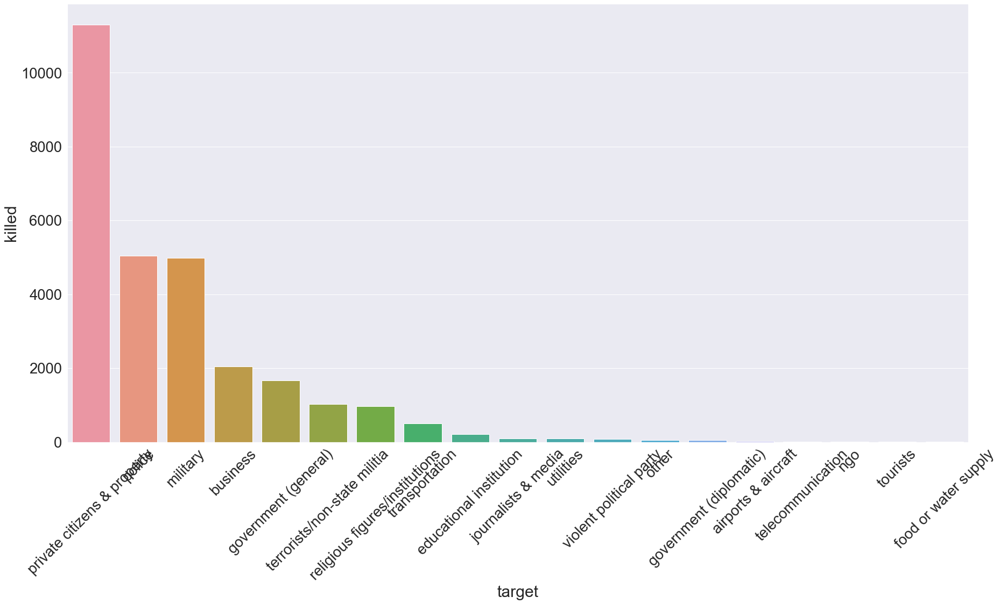

In [49]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = iraq_killed_df, x = 'target', y ='killed')

In [50]:
somalia_killed= country_dict['somalia'].groupby(['target'])['killed'].agg('sum').sort_values(ascending = False)
somalia_killed_df = pd.DataFrame(somalia_killed).reset_index()

<AxesSubplot:xlabel='target', ylabel='killed'>

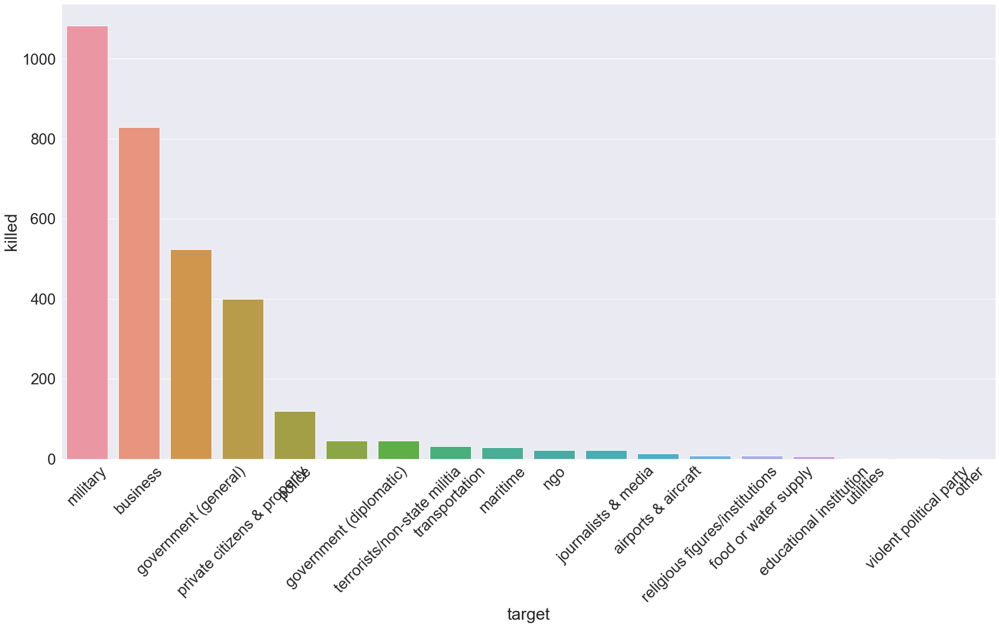

In [51]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = somalia_killed_df, x = 'target', y ='killed')

In [52]:
afghanistan_killed= country_dict['afghanistan'].groupby(['target'])['killed'].agg('sum').sort_values(ascending = False)
afghanistan_killed_df = pd.DataFrame(afghanistan_killed).reset_index()

<AxesSubplot:xlabel='target', ylabel='killed'>

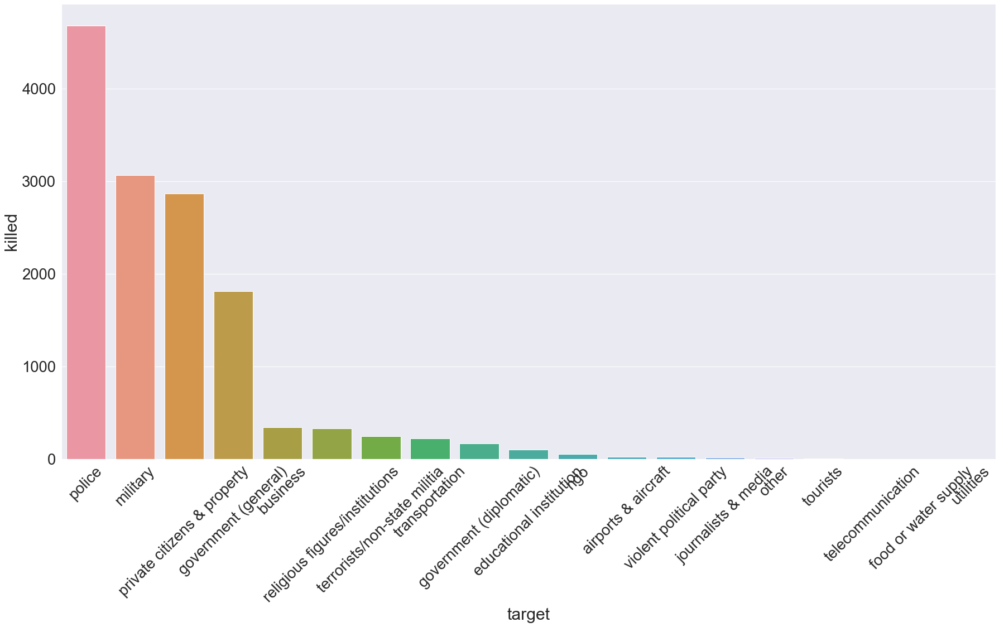

In [53]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = afghanistan_killed_df, x = 'target', y ='killed')

In [54]:
pakistan_killed= country_dict['pakistan'].groupby(['target'])['killed'].agg('sum').sort_values(ascending = False)
pakistan_killed_df = pd.DataFrame(pakistan_killed).reset_index()

<AxesSubplot:xlabel='target', ylabel='killed'>

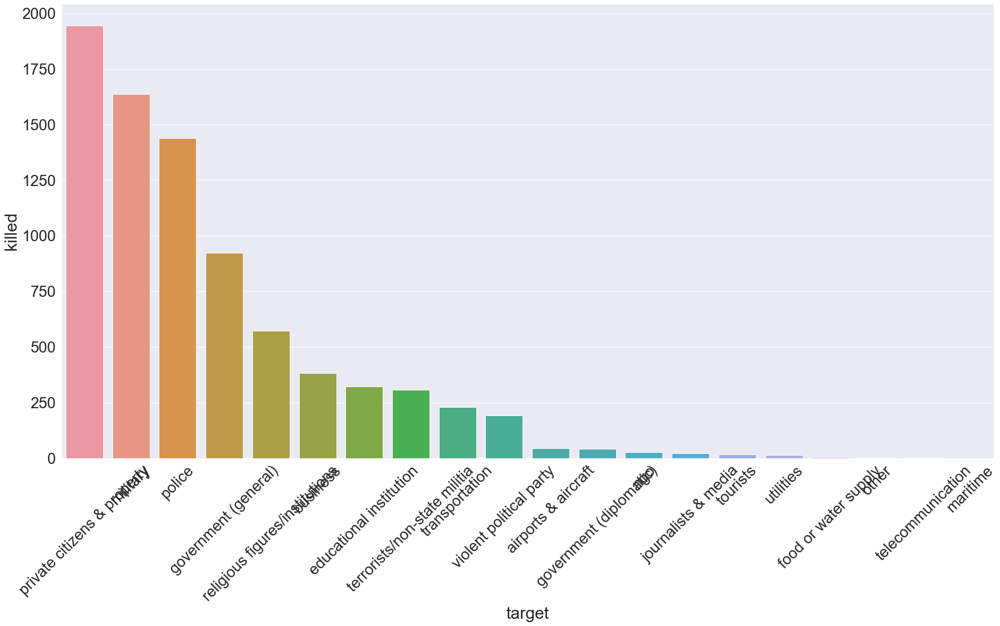

In [55]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = pakistan_killed_df, x = 'target', y ='killed')

In [56]:
egypt_killed= country_dict['egypt'].groupby(['target'])['killed'].agg('sum').sort_values(ascending = False)
egypt_killed_df = pd.DataFrame(egypt_killed).reset_index()

<AxesSubplot:xlabel='target', ylabel='killed'>

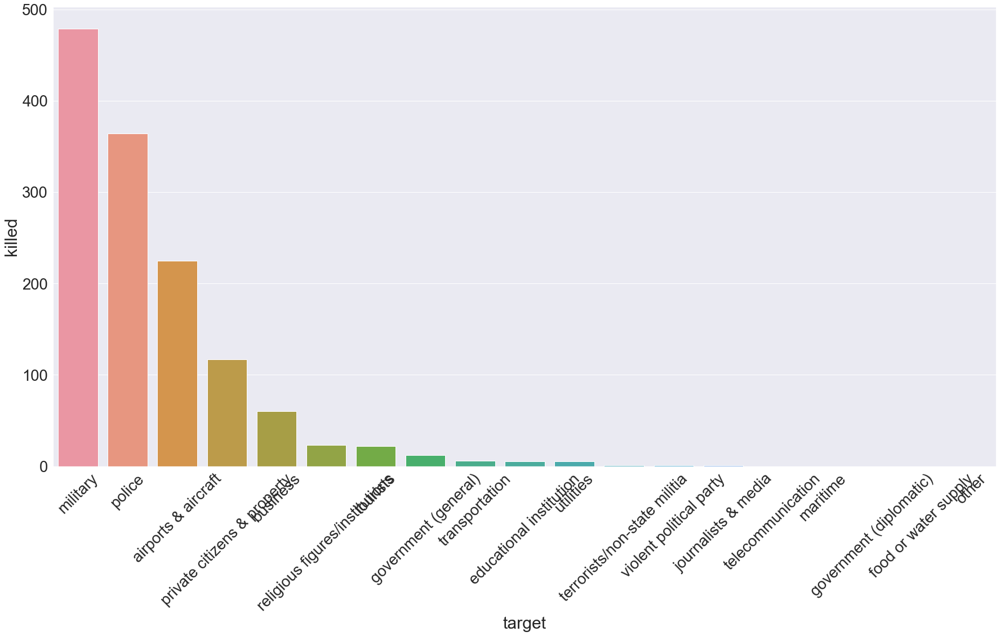

In [57]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = egypt_killed_df, x = 'target', y ='killed')

In [58]:
months_killed_egypt= country_dict['egypt'].groupby(['month'])['killed'].agg('sum').sort_values(ascending = False)
months_killed_egypt_df = pd.DataFrame(months_killed_egypt).reset_index().sort_values('month')

In [59]:
months_killed_somalia= country_dict['somalia'].groupby(['month'])['killed'].agg('sum').sort_values(ascending = False)
months_killed_somalia_df = pd.DataFrame(months_killed_somalia).reset_index().sort_values('month')

In [60]:
months_killed_iraq= country_dict['iraq'].groupby(['month'])['killed'].agg('sum').sort_values(ascending = False)
months_killed_iraq_df = pd.DataFrame(months_killed_iraq).reset_index().sort_values('month')

In [61]:
months_killed_pakistan= country_dict['pakistan'].groupby(['month'])['killed'].agg('sum').sort_values(ascending = False)
months_killed_pakistan_df = pd.DataFrame(months_killed_pakistan).reset_index().sort_values('month')

In [62]:
months_killed_afghanistan= country_dict['afghanistan'].groupby(['month'])['killed'].agg('sum').sort_values(ascending = False)
months_killed_afghanistan_df = pd.DataFrame(months_killed_afghanistan).reset_index().sort_values('month')

Text(0.5, 1.0, 'egypt killed by month')

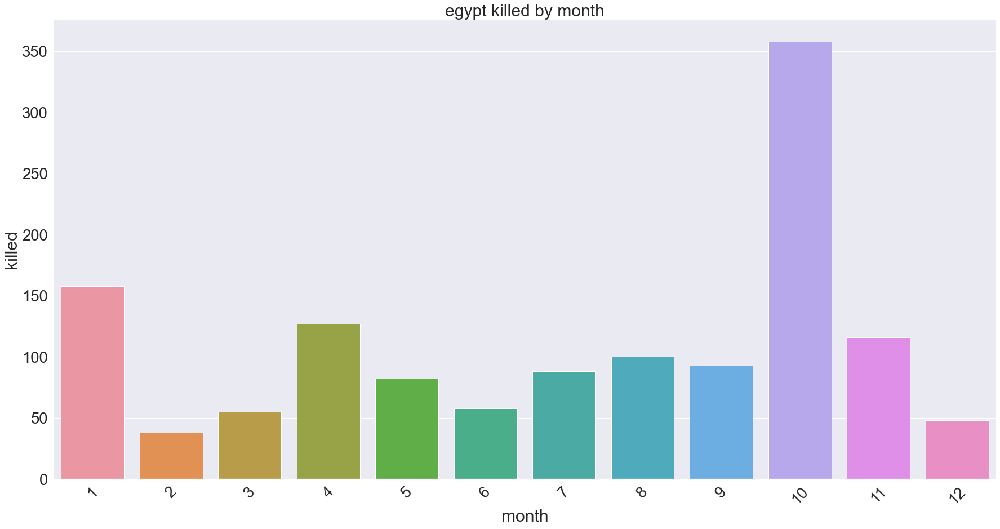

In [63]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_egypt_df, x = 'month', y ='killed')
plt.title('egypt killed by month')

Text(0.5, 1.0, 'afghanistan killed by month')

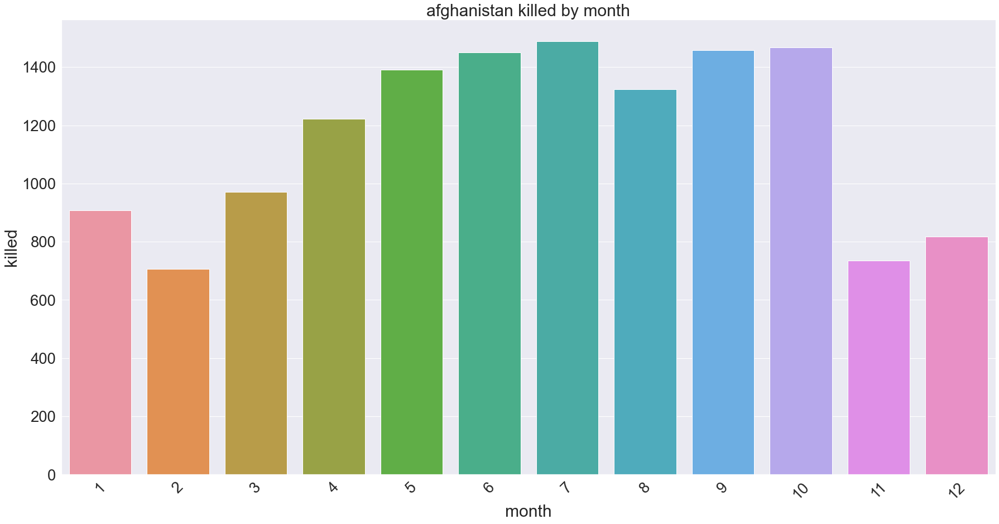

In [64]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_afghanistan_df, x = 'month', y ='killed')
plt.title('afghanistan killed by month')

Text(0.5, 1.0, 'pakistan killed by month')

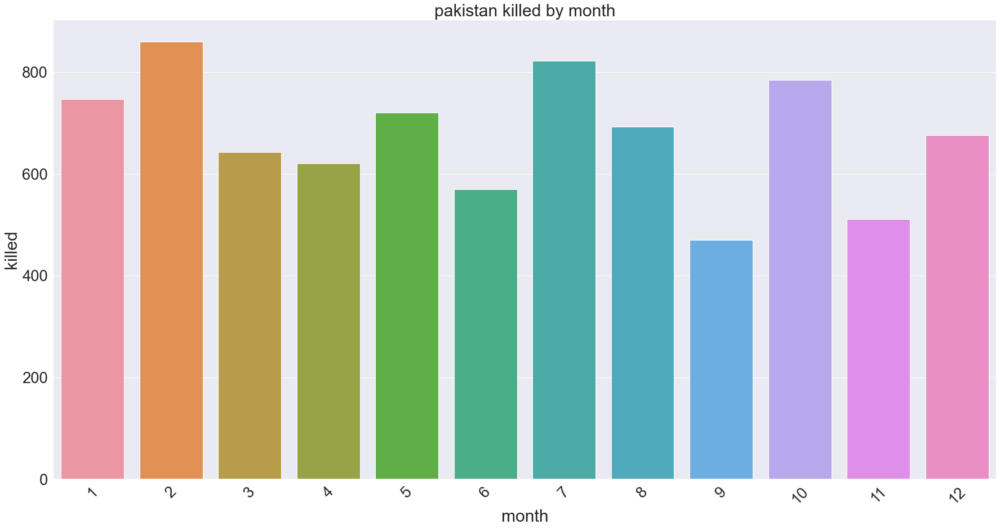

In [65]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_pakistan_df, x = 'month', y ='killed')
plt.title('pakistan killed by month')

Text(0.5, 1.0, 'iraq killed by month')

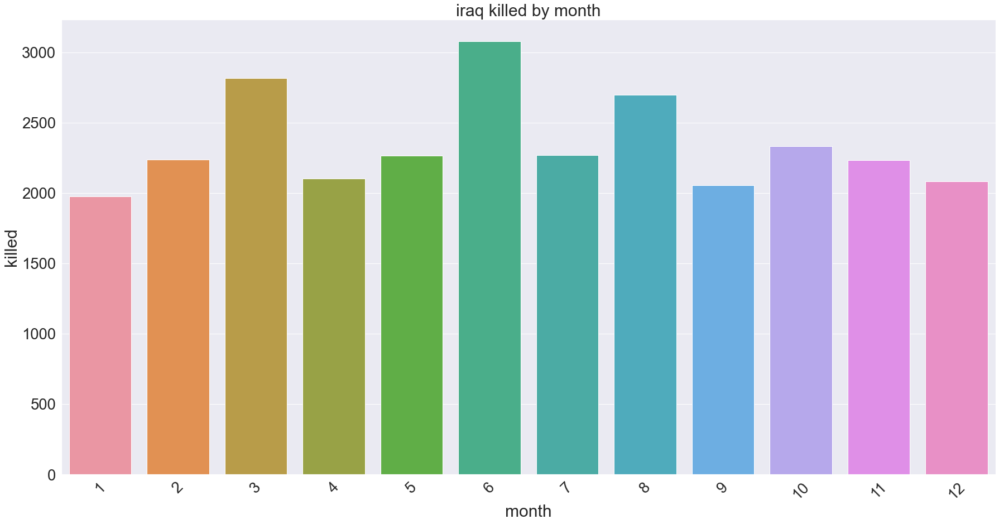

In [66]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_iraq_df, x = 'month', y ='killed')
plt.title('iraq killed by month')

Text(0.5, 1.0, 'somalia killed by month')

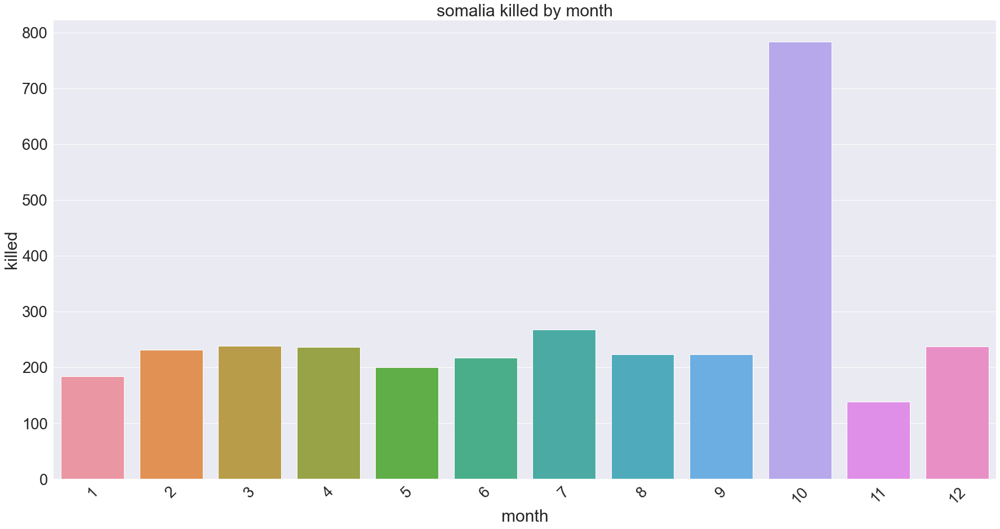

In [67]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_somalia_df, x = 'month', y ='killed')
plt.title('somalia killed by month')

Is there a relationship between the month and the number of people killed?

In [68]:
months_killed_overall=train.groupby(['month'])['killed'].agg('mean').sort_values(ascending = False)
months_killed_overall_df = pd.DataFrame(months_killed_overall).reset_index().sort_values('month')
months_killed_overall_df

,month,killed
10,1,2.158715
9,2,2.334858
3,3,2.524534
8,4,2.350048
6,5,2.418029
1,6,2.877065
4,7,2.497265
2,8,2.566160
5,9,2.475848
0,10,3.135875


Text(0.5, 1.0, 'overall killed by month')

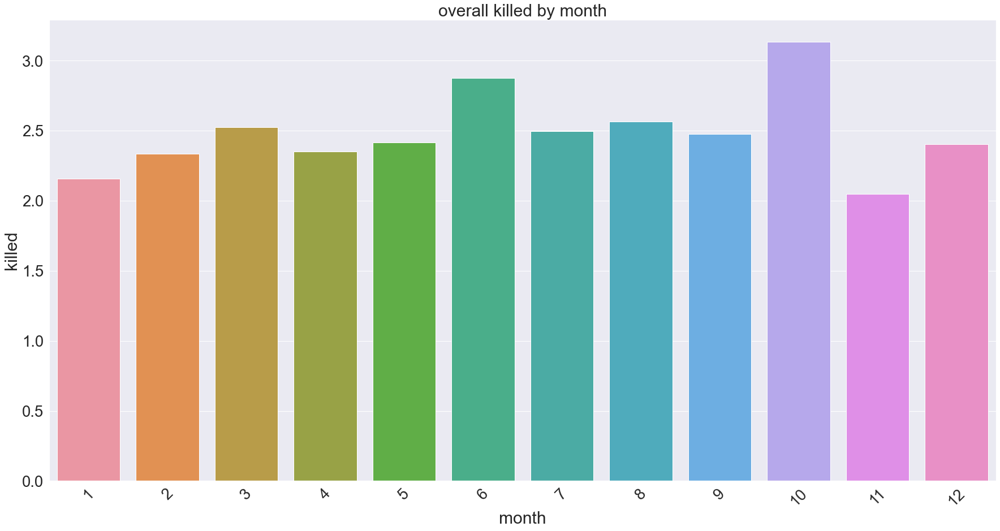

In [69]:
plt.figure(figsize=(30,15))
sns.set(font_scale=2.5)
plt.xticks(rotation=45)
sns.barplot(data = months_killed_overall_df, x = 'month', y ='killed')
plt.title('overall killed by month')

In [70]:
#one-way anova test 
# null hypothesis - there is no relationship between the month and how many people were killed
# alt hypothesis - There is a relationship between the month and number killed. 

alpha = 0.05
F, p = stats.f_oneway(train.month, train.killed)
F, p
if p < alpha:
    print('p = ', p, 'There is a relationship between the two variables')
else:
    print('There is no relationship between the two variables')

p =  0.0 There is a relationship between the two variables


# Is there a relationship between the different targeted groups and the terrorist groups

In [71]:
fig = px.histogram(train, x="target", title = 'count of groups being attacked',
                   labels={'count':'Number of Reported Attacks'}, color="atk_group")


In [72]:
fig.show()

- Four groups really stand out above all others as the ones being attacked the most frequently. They are :
    - Private citizens and property, police, military, and general government. 
 

In [73]:
## is there a relationship between the type of targeted groups and and the terrorist group?
## chi2 test 
## null hypothesis- there is no relationship between the targeted groups and the terrorist groups
## alt hypothesis- there is a relationship between the targeted group and attack groups
alpha = .05

target_table = pd.crosstab(train.target, train.atk_group)

chi2, p, degf, expected = stats.chi2_contingency(target_table)

print('Observed\n')
print(target_table.values)
print('---\nExpected\n')
print(expected)
print('---\n')
print(f'chi^2 = {chi2:.4f}')
print(f'p     = {p:.4f}')

if p < alpha:
    print('Reject the null')
else:
    print('Fail to reject the null')

Observed

[[0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
---
Expected

[[0.00572304 0.00858456 0.00286152 ... 0.00286152 0.00286152 0.00286152]
 [0.13146864 0.19720297 0.06573432 ... 0.06573432 0.06573432 0.06573432]
 [0.05529582 0.08294374 0.02764791 ... 0.02764791 0.02764791 0.02764791]
 ...
 [0.04336611 0.06504917 0.02168306 ... 0.02168306 0.02168306 0.02168306]
 [0.03941641 0.05912462 0.01970821 ... 0.01970821 0.01970821 0.01970821]
 [0.01950669 0.02926004 0.00975335 ... 0.00975335 0.00975335 0.00975335]]
---

chi^2 = 18408.4908
p     = 0.0000
Reject the null


- Takeaway: There is a relationship between the targeted groups and the terrorist groups that are attacking them

In [74]:
# make sure that the groups that are the most targeted also have the highest number of deaths
fig2 = px.bar(train, x="target", y = 'killed', title = 'kill count of groups being attacked',
                   labels={'count':'Number of Reported Attacks'}, color="atk_group")
fig.update_traces(dict(marker_line_width=0))
fig2.show()

- The groups that are the most targeted also seem to have the highest numbers of deaths overall. 

In [75]:
## is there a relationship between the type of targeted group and death toll?
## chi2 test 
## null hypothesis- there is no relationship between the targeted groups and the death toll
## alt hypothesis- there is a relationship between the targeted groups and the death toll
alpha = .05

targets_killed_table = pd.crosstab(train.target, train.killed)

chi2, p, degf, expected = stats.chi2_contingency(targets_killed_table)

print('Observed\n')
print(targets_killed_table.values)
print('---\nExpected\n')
print(expected)
print('---\n')
print(f'chi^2 = {chi2:.4f}')
print(f'p     = {p:.4f}')

if p < alpha:
    print('Reject the null')
else:
    print('Fail to reject the null')

Observed

[[ 48  12   2 ...   0   0   0]
 [661 401 262 ...   0   1   0]
 [472 133  36 ...   0   0   0]
 ...
 [266  86  53 ...   0   0   0]
 [456  15   8 ...   0   0   0]
 [ 81 105  29 ...   0   0   0]]
---
Expected

[[2.64289860e+01 1.93266968e+01 8.90790746e+00 ... 5.72303724e-03
  2.86151862e-03 2.86151862e-03]
 [6.07122199e+02 4.43969611e+02 2.04630945e+02 ... 1.31468644e-01
  6.57343221e-02 6.57343221e-02]
 [2.55356118e+02 1.86734000e+02 8.60679510e+01 ... 5.52958246e-02
  2.76479123e-02 2.76479123e-02]
 ...
 [2.00264711e+02 1.46447364e+02 6.74993552e+01 ... 4.33661132e-02
  2.16830566e-02 2.16830566e-02]
 [1.82024988e+02 1.33109221e+02 6.13516444e+01 ... 3.94164114e-02
  1.97082057e-02 1.97082057e-02]
 [9.00818959e+01 6.58740932e+01 3.03621635e+01 ... 1.95066903e-02
  9.75334516e-03 9.75334516e-03]]
---

chi^2 = 3695.6248
p     = 0.0000
Reject the null


- Takeaway: There is a relationship between the targeted groups and how many people are dying.

In [76]:
## side graph- terrorist groups change over time
atk_group_fig = px.histogram(train, x="year", title = 'groups change over time',
                   labels={'count':'Number of Reported Attacks'}, color="atk_group")
atk_group_fig.show()

- As certain groups tend to fall off, other groups seem to take their place. an example of this is the fall off of al-qaida in iraq from 2012-2013 let to the establishment of isil during the same time. 
- Other groups such as the taliban seem to remain power players in the region, but still ramp up operations in 2012

## what nationalities are most at risk? 

In [77]:
## side graph- terrorist groups change over time
natl_group_fig = px.histogram(train, x="nationality", title = 'nationalities being targeted',
                   labels={'count':'Number of Reported Attacks'}, color="atk_group")
natl_group_fig.show()

- The nationalities that are the most at risk relates to the countries that have the most terrorist attacks. They are:
    -afghanistan, pakistan, egypt, iraq, somalia

# what method of attack is a group most likely to use?

In [78]:
list(terrorist_dict)

['unknown',
 'taliban',
 'islamic state of iraq and the levant (isil)',
 'al-shabaab',
 'al-qaida in iraq',
 'khorasan chapter of the islamic state',
 'tehrik-i-taliban pakistan (ttp)',
 "kurdistan workers' party (pkk)",
 'sudan liberation movement',
 'military council of the tribal revolutionaries (mctr)',
 'misseriya arab tribesmen',
 'hasam movement',
 'islamic state in egypt',
 'sinai province of the islamic state',
 'hamas (islamic resistance movement)',
 'devrimici halk kurtulus cephesi (dhkp/c)',
 'janjaweed',
 'baloch republican army (bra)',
 'united baloch army (uba)',
 'lashkar-e-islam (pakistan)',
 'haqqani network',
 'al-nusrah front',
 'palestinian islamic jihad (pij)',
 'free syrian army',
 'tehrik-e-khilafat',
 'islamic front (syria)',
 'jaysh al-islam (syria)',
 'islamic state of iraq (isi)',
 'balochistan liberation united front (bluf)',
 'israeli extremists',
 'khaled ibn al-walid army',
 'lashkar-e-jhangvi',
 'baloch liberation front (blf)',
 'tajamo ansar al-islam',

In [79]:
terrorist_dict['taliban'].weap_type.value_counts()

explosives    1405
firearms      1150
incendiary      89
melee           37
chemical         6
Name: weap_type, dtype: int64

In [80]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    terrorist_dict['taliban'], 
    x = 'weap_type', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="weapon types of taliban"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- The taliban's primary weapons are explosives and firearms, but they also use incendiary and melee

In [81]:
# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    terrorist_dict['islamic state of iraq and the levant (isil)'], 
    x = 'weap_type', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="weapon types of isil"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- ISIL primarily uses explosives

In [82]:

# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    terrorist_dict['al-qaida in iraq'], 
    x = 'weap_type', 
    animation_frame="year", 
    range_y = [0,500],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="weapon types of al-qaida"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- al-qaida uses both explosives and firearms

In [83]:

# create a histogram of the top groups over the time frame
color_discrete_map = {'unknown': '#006ba4'}
fig = px.histogram(
    terrorist_dict['al-shabaab'], 
    x = 'weap_type', 
    animation_frame="year", 
    range_y = [0,50],
    range_x = [0,50],
    color_discrete_map = color_discrete_map,
    title="weapon types of al-shabaab"
)
fig.update_layout(
  template='ggplot2')
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500

fig.show()

- al-shabaab uses explosives and firearms as well, but like the taliban, they also use melee and incendiary

In [84]:
## is there a relationship between the type of weapon and the group?
## chi2 test 
## null hypothesis- there is no relationship between the groups and the weapons that they use
## alt hypothesis- there is a relationship between the group and the weapons they use
alpha = .05

weapons_table = pd.crosstab(train.weap_type, train.atk_group)

chi2, p, degf, expected = stats.chi2_contingency(weapons_table)

print('Observed\n')
print(weapons_table.values)
print('---\nExpected\n')
print(expected)
print('---\n')
print(f'chi^2 = {chi2:.4f}')
print(f'p     = {p:.4f}')

if p < alpha:
    print('Reject the null')
else:
    print('Fail to reject the null')

Observed

[[0 0 0 ... 0 0 0]
 [2 3 0 ... 0 1 0]
 [0 0 1 ... 1 0 1]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
---
Expected

[[3.30485249e-03 4.95727874e-03 1.65242625e-03 ... 1.65242625e-03
  1.65242625e-03 1.65242625e-03]
 [1.37320651e+00 2.05980977e+00 6.86603256e-01 ... 6.86603256e-01
  6.86603256e-01 6.86603256e-01]
 [5.72545542e-01 8.58818314e-01 2.86272771e-01 ... 2.86272771e-01
  2.86272771e-01 2.86272771e-01]
 [3.16782202e-02 4.75173303e-02 1.58391101e-02 ... 1.58391101e-02
  1.58391101e-02 1.58391101e-02]
 [1.92648718e-02 2.88973078e-02 9.63243592e-03 ... 9.63243592e-03
  9.63243592e-03 9.63243592e-03]]
---

chi^2 = 5747.9621
p     = 0.0000
Reject the null


- Takeaway: There is a relationship between the terrorist group and the kinds of weapons that they use

In [85]:
train.T

,47718,19456,25865,22699,19572,18972,25886,37122,32698,47209,...,6930,50051,42659,60271,35199,51373,41422,58151,36867,56729
eventid,201511290012,201207140007,201307240011,201302190017,201207220002,201206130015,201307240041,201408260079,201404030029,201511060012,...,200806240004,201603140043,201504270067,201707190031,201406230010,201605140010,201502280009,201703270003,201408180024,201701070012
year,2015,2012,2013,2013,2012,2012,2013,2014,2014,2015,...,2008,2016,2015,2017,2014,2016,2015,2017,2014,2017
month,11,7,7,2,7,6,7,8,4,11,...,6,3,4,7,6,5,2,3,8,1
day,29,14,24,19,21,13,23,26,3,6,...,24,14,27,20,23,14,27,27,18,7
country,afghanistan,afghanistan,iraq,somalia,egypt,iraq,afghanistan,iraq,pakistan,iraq,...,iraq,egypt,iraq,afghanistan,afghanistan,iraq,afghanistan,sudan,egypt,iraq
region,south asia,south asia,middle east & north africa,sub-saharan africa,middle east & north africa,middle east & north africa,south asia,middle east & north africa,south asia,middle east & north africa,...,middle east & north africa,middle east & north africa,middle east & north africa,south asia,south asia,middle east & north africa,south asia,sub-saharan africa,middle east & north africa,middle east & north africa
provstate,kabul,kandahar,saladin,banaadir,north sinai,al anbar,badghis,baghdad,balochistan,baghdad,...,kirkuk,north sinai,baghdad,nangarhar,zabul,diyala,nangarhar,north darfur,gharbia,al qadisiyah
city,kabul,kandahar,sulayman beg,mogadishu,arish,abu ghraib,laman,baghdad,bostan,baghdad,...,kirkuk,sheikh zuweid,baghdad,chaparhar district,shah hasankhel,madain,kama district,el fashir district,as santah,diwaniyah
latitude,34.516895,31.631083,34.790665,2.059819,31.126646,33.31065,34.752222,33.303566,30.431589,33.303566,...,35.45211,31.212225,33.303566,34.286209,32.354408,33.100529,34.41808,13.579714,30.747309,31.98958
longitude,69.147011,65.742226,44.662151,45.326115,33.800865,44.038208,63.104167,44.371773,67.017731,44.371773,...,44.375465,34.117065,44.371773,70.362733,67.257683,44.584492,70.649529,25.032026,31.130546,44.923775


In [86]:
fig = px.scatter(train, x = 'year', y = 'wounded', color = 'weap_type', size = 'wounded' )
fig.show()

# Exploration Takeaways:
- The most active terrorist groups are:
    - ISIL, Al-qaida, taliban
- The most active countries are:
    - Iraq, pakistan, egypt, somalia, afghanistan
- The most targeted groups are:
    - police, military, private citizens/property, general government
- The most common forms of attack are:
    - armed assault and explosions/bombing

# Modeling

In [87]:
# df["is_other"] = (~ df.attack_type.isin(attack_list)).astype(int)

In [88]:
# first establish what columns i want to drop from df
cols_to_drop =['eventid',
 'year',
 'month',
 'day',
 'country',
 'region',
 'provstate',
 'city',
 'latitude',
 'longitude',
 'success',
 'suicide',
 'attack_type',
 'targ_desc',
 'targeted_group',
 'tg_desc',
 'nationality',
 'atk_group',
 'claimed',
 'weap_type',
 'weap_sub',
 'killed',
 'us_killed',
 'ter_killed',
 'wounded',
 'us_wounded',
 'ter_wounded',
 'property']

In [89]:
# establish seperate df for unencoded values
df3 = df.drop(cols_to_drop, axis = 1)

In [90]:
df.T

,0,1,3,6,7,8,10,11,12,13,...,62713,62714,62716,62717,62718,62719,62720,62721,62722,62723
eventid,200101010004,200101030001,200101070003,200101080002,200101100004,200101110003,200101210006,200101220006,200101230007,200101240001,...,201712310004,201712310006,201712310008,201712310009,201712310012,201712310013,201712310018,201712310020,201712310022,201712310029
year,2001,2001,2001,2001,2001,2001,2001,2001,2001,2001,...,2017,2017,2017,2017,2017,2017,2017,2017,2017,2017
month,1,1,1,1,1,1,1,1,1,1,...,12,12,12,12,12,12,12,12,12,12
day,1,3,7,8,10,11,21,22,23,24,...,31,31,31,31,31,31,31,31,31,31
country,turkey,turkey,turkey,turkey,turkey,israel,iran,afghanistan,turkey,turkey,...,iraq,afghanistan,somalia,afghanistan,iraq,somalia,afghanistan,afghanistan,somalia,syria
region,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,south asia,middle east & north africa,middle east & north africa,...,middle east & north africa,south asia,sub-saharan africa,south asia,middle east & north africa,sub-saharan africa,south asia,south asia,sub-saharan africa,middle east & north africa
provstate,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,mersin,diyarbakir,...,saladin,nangarhar,banaadir,logar,diyala,bakool,faryab,faryab,middle shebelle,lattakia
city,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,unknown,diyarbakir,...,farhatiyah,jalalabad,mogadishu,mohammad agha district,muqdadiyah,wajid,kohistan district,maymana,ceelka geelow,jableh
latitude,41.106178,41.106178,41.106178,41.106178,41.106178,31.771599,35.724533,34.516895,36.806853,37.922218,...,34.031331,34.417122,2.059819,34.217806,33.953167,3.810951,35.315467,35.921051,2.359673,35.407278
longitude,28.689863,28.689863,28.689863,28.689863,28.689863,35.2034,51.40519,69.147011,34.628893,40.184376,...,44.070106,70.449593,45.326115,69.109316,44.921906,43.246506,64.815508,64.774544,45.385034,35.942679


In [91]:
df.attack_type.value_counts()

bombing/explosion                      28555
armed assault                          10159
assassination                           3302
hostage taking (kidnapping)             1307
facility/infrastructure attack           772
hostage taking (barricade incident)       86
unarmed assault                           74
hijacking                                 54
Name: attack_type, dtype: int64

In [92]:
df2_trial = df.copy()

In [93]:
df2_trial['attack_type'] = df2_trial.attack_type.replace(['hijacking'], 'other') 
df2_trial['attack_type'] = df2_trial.attack_type.replace(['unarmed assault'], 'other') 
df2_trial['attack_type'] = df2_trial.attack_type.replace(['hostage taking (barricade incident)'], 'other') 
df2_trial['attack_type'] = df2_trial.attack_type.replace(['facility/infrastructure attack'], 'other') 
df2_trial['attack_type'] = df2_trial.attack_type.replace(['hostage taking (kidnapping)'], 'other') 
df2_trial['country'] = df2_trial.country.replace(['turkey'], 'other')
df2_trial['country'] = df2_trial.country.replace(['syria'], 'other')
df2_trial['country'] = df2_trial.country.replace(['israel'], 'other')
df2_trial['country'] = df2_trial.country.replace(['sudan'], 'other')
df2_trial['country'] = df2_trial.country.replace(['lebanon'], 'other')
df2_trial['country'] = df2_trial.country.replace(['saudi arabia'], 'other')
df2_trial['country'] = df2_trial.country.replace(['bahrain'], 'other')
df2_trial['country'] = df2_trial.country.replace(['iran'], 'other')
df2_trial['country'] = df2_trial.country.replace(['jordan'], 'other')
df2_trial['country'] = df2_trial.country.replace(['kuwait'], 'other')
df2_trial['country'] = df2_trial.country.replace(['qatar'], 'other')
df2_trial['country'] = df2_trial.country.replace(['djibouti'], 'other')
df2_trial['weap_type'] = df2_trial.weap_type.replace(['melee'], 'other')
df2_trial['weap_type'] = df2_trial.weap_type.replace(['chemical'], 'other')

In [94]:
df3.value_counts()

target                        
private citizens & property       12194
police                             8866
military                           8011
government (general)               4836
business                           2984
terrorists/non-state militia       1348
educational institution            1239
religious figures/institutions     1188
transportation                      929
utilities                           879
government (diplomatic)             477
violent political party             383
journalists & media                 355
ngo                                 211
airports & aircraft                 137
telecommunication                   108
other                                58
food or water supply                 55
tourists                             36
maritime                             15
dtype: int64

In [95]:
df2_trial.nationality.value_counts()

iraq           17616
pakistan        8974
afghanistan     7503
somalia         1957
egypt           1594
               ...  
ukraine            1
yemen              1
oman               1
greece             1
myanmar            1
Name: nationality, Length: 87, dtype: int64

In [96]:
bottom = df2_trial.nationality.value_counts().index.to_list()

In [97]:
bottom = bottom[10:]

In [98]:
df2_trial.nationality = df2_trial.nationality.replace(bottom, 'other')

In [99]:
bottom_city = df2_trial.city.value_counts().index.to_list()


In [100]:
bottom_city = bottom_city[25:]

In [101]:
df2_trial.city = df2_trial.city.replace(bottom_city, 'other')

In [102]:
# encoded df
encoded_df = pd.get_dummies(df2_trial[['attack_type','suicide', 'month', 'country', 'provstate', 'year', 'weap_type', 'nationality', 'city']], dummy_na=False, drop_first=[True, True])

In [103]:
df3 = df3.replace(['educational institution'], 'other')
df3 = df3.replace(['religious figures/institutions'], 'other')
df3 = df3.replace(['transportation'], 'other')
df3 = df3.replace(['utilities'], 'other')
df3 = df3.replace(['government (diplomatic)'], 'other')
df3 = df3.replace(['violent political party'], 'other')
df3 = df3.replace(['journalists & media'], 'other')
df3 = df3.replace(['ngo'], 'other')
df3 = df3.replace(['airports & aircraft'], 'other')
df3 = df3.replace(['telecommunication'], 'other')
df3 = df3.replace(['food or water supply'], 'other')
df3 = df3.replace(['tourists'], 'other')
df3 = df3.replace(['maritime'], 'other')
df3 = df3.replace(['terrorists/non-state militia'], 'other')
df3 = df3.replace(['business'], 'other')

In [104]:
# concat dfs together
df2 = pd.concat([df3, encoded_df], axis = 1)

In [105]:
#split the data
encoded_train, encoded_validate, encoded_test = wrangle.split_data(df2)
encoded_train.shape, encoded_validate.shape, encoded_test.shape

((24812, 309), (10635, 309), (8862, 309))

In [106]:
# My baseline is going to be 27% since we are trying to predict the most targeted group. 
# If we predict that the private citizens & property, we are right 28% of the time
baseline = round((6883/len(train.target))*100,2)
print ('The baseline accuracy is', baseline, '%')

The baseline accuracy is 27.74 %


In [107]:
X_train = encoded_train.drop(columns=["target"])
y_train = encoded_train.target

X_validate = encoded_validate.drop(columns=["target"])
y_validate = encoded_validate.target

X_test = encoded_test.drop(columns=["target"])
y_test = encoded_test.target

In [108]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE

# initialize the ML algorithm
rf = RandomForestClassifier()

# create the rfe object, indicating the ML object (lm) and the number of features I want to end up with. 
rfe = RFE(rf, n_features_to_select=50)

# fit the data using RFE
rfe.fit(X_train,y_train)  

# get the mask of the columns selected
feature_mask = rfe.support_

# get list of the column names. 
rfe_feature = X_train.iloc[:,feature_mask].columns.tolist()


In [109]:
metrics = []

for i in range(1, 30):

    tree = DecisionTreeClassifier(max_depth=i, random_state=17)


    tree = tree.fit(X_train, y_train)


    in_sample_accuracy = tree.score(X_train, y_train)
    
    out_of_sample_accuracy = tree.score(X_validate, y_validate)

    output = {
        "max_depth": i,
        "train_accuracy": in_sample_accuracy,
        "validate_accuracy": out_of_sample_accuracy
    }
    
    metrics.append(output)
    
dt_df = pd.DataFrame(metrics)
dt_df["difference"] = dt_df.train_accuracy - dt_df.validate_accuracy
dt_df

,max_depth,train_accuracy,validate_accuracy,difference
0,1,0.300177,0.287541,0.012636
1,2,0.320974,0.306911,0.014063
2,3,0.354224,0.342172,0.012052
3,4,0.358375,0.345557,0.012818
4,5,0.380663,0.366055,0.014607
5,6,0.401540,0.380536,0.021004
6,7,0.419636,0.397179,0.022457
7,8,0.439868,0.414386,0.025481
8,9,0.449178,0.421627,0.027551
9,10,0.462599,0.429901,0.032697


In [110]:
metrics = []

for i in range(1, 40):

    tree = RandomForestClassifier(bootstrap = True, 
                                  class_weight = None,
                                  criterion = 'gini', 
                                  min_samples_leaf = 3, 
                                  n_estimators = 150,
                                  max_depth=i,
                                  random_state=17)


    tree = tree.fit(X_train, y_train)


    in_sample_accuracy = tree.score(X_train, y_train)
    
    out_of_sample_accuracy = tree.score(X_validate, y_validate)

    output = {
        "max_depth": i,
        "train_accuracy": in_sample_accuracy,
        "validate_accuracy": out_of_sample_accuracy
    }
    
    metrics.append(output)
    
rf_df = pd.DataFrame(metrics)
rf_df["difference"] = rf_df.train_accuracy - rf_df.validate_accuracy
rf_df

,max_depth,train_accuracy,validate_accuracy,difference
0,1,0.277406,0.266479,0.010927
1,2,0.316379,0.303902,0.012477
2,3,0.345357,0.334368,0.010989
3,4,0.358093,0.347156,0.010937
4,5,0.388643,0.373672,0.014971
5,6,0.400048,0.385802,0.014247
6,7,0.418991,0.398307,0.020683
7,8,0.426326,0.407616,0.018710
8,9,0.441561,0.417866,0.023695
9,10,0.444986,0.422097,0.022889


In [111]:
metrics = []

for i in range(1, 50):

    tree = KNeighborsClassifier(n_neighbors=i, weights='uniform')


    tree = tree.fit(X_train, y_train)


    in_sample_accuracy = tree.score(X_train, y_train)
    
    out_of_sample_accuracy = tree.score(X_validate, y_validate)

    output = {
        "max_depth": i,
        "train_accuracy": in_sample_accuracy,
        "validate_accuracy": out_of_sample_accuracy
    }
    
    metrics.append(output)
    
knn_df = pd.DataFrame(metrics)
knn_df["difference"] = knn_df.train_accuracy - knn_df.validate_accuracy
knn_df

,max_depth,train_accuracy,validate_accuracy,difference
0,1,0.716790,0.382417,0.334374
1,2,0.590077,0.360414,0.229664
2,3,0.594833,0.389187,0.205646
3,4,0.587095,0.410531,0.176564
4,5,0.577342,0.417113,0.160228
5,6,0.562228,0.420686,0.141542
6,7,0.555417,0.423695,0.131721
7,8,0.549129,0.424824,0.124306
8,9,0.539699,0.432064,0.107635
9,10,0.532122,0.428679,0.103443


In [112]:
X_train.shape

(24812, 308)

In [113]:
df3.target.value_counts()

private citizens & property    12194
other                          10402
police                          8866
military                        8011
government (general)            4836
Name: target, dtype: int64

In [114]:
df.T

,0,1,3,6,7,8,10,11,12,13,...,62713,62714,62716,62717,62718,62719,62720,62721,62722,62723
eventid,200101010004,200101030001,200101070003,200101080002,200101100004,200101110003,200101210006,200101220006,200101230007,200101240001,...,201712310004,201712310006,201712310008,201712310009,201712310012,201712310013,201712310018,201712310020,201712310022,201712310029
year,2001,2001,2001,2001,2001,2001,2001,2001,2001,2001,...,2017,2017,2017,2017,2017,2017,2017,2017,2017,2017
month,1,1,1,1,1,1,1,1,1,1,...,12,12,12,12,12,12,12,12,12,12
day,1,3,7,8,10,11,21,22,23,24,...,31,31,31,31,31,31,31,31,31,31
country,turkey,turkey,turkey,turkey,turkey,israel,iran,afghanistan,turkey,turkey,...,iraq,afghanistan,somalia,afghanistan,iraq,somalia,afghanistan,afghanistan,somalia,syria
region,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,middle east & north africa,south asia,middle east & north africa,middle east & north africa,...,middle east & north africa,south asia,sub-saharan africa,south asia,middle east & north africa,sub-saharan africa,south asia,south asia,sub-saharan africa,middle east & north africa
provstate,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,mersin,diyarbakir,...,saladin,nangarhar,banaadir,logar,diyala,bakool,faryab,faryab,middle shebelle,lattakia
city,istanbul,istanbul,istanbul,istanbul,istanbul,jerusalem,tehran,kabul,unknown,diyarbakir,...,farhatiyah,jalalabad,mogadishu,mohammad agha district,muqdadiyah,wajid,kohistan district,maymana,ceelka geelow,jableh
latitude,41.106178,41.106178,41.106178,41.106178,41.106178,31.771599,35.724533,34.516895,36.806853,37.922218,...,34.031331,34.417122,2.059819,34.217806,33.953167,3.810951,35.315467,35.921051,2.359673,35.407278
longitude,28.689863,28.689863,28.689863,28.689863,28.689863,35.2034,51.40519,69.147011,34.628893,40.184376,...,44.070106,70.449593,45.326115,69.109316,44.921906,43.246506,64.815508,64.774544,45.385034,35.942679


In [115]:
dummy_df = pd.get_dummies(df[['country',
                               'provstate',
                               'city',
                              'nationality',
                              'month',
                              'attack_type',
                              'atk_group', 
                              'weap_type',
                              'weap_sub']], dummy_na=False, drop_first=[True, True])
df_trial = pd.concat([df3, dummy_df], axis = 1)

In [116]:
df_trial.T

,0,1,3,6,7,8,10,11,12,13,...,62713,62714,62716,62717,62718,62719,62720,62721,62722,62723
target,private citizens & property,police,police,other,police,private citizens & property,government (general),other,government (general),police,...,private citizens & property,private citizens & property,military,police,military,military,other,other,military,military
month,1,1,1,1,1,1,1,1,1,1,...,12,12,12,12,12,12,12,12,12,12
country_bahrain,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
country_djibouti,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
country_egypt,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
weap_sub_time fuse,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
weap_sub_unknown explosive type,0,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,1,0,0
weap_sub_unknown gun type,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,1,0,1,0,1,0
weap_sub_unknown weapon type,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [117]:
df_trial.target.value_counts()

private citizens & property    12194
other                          10402
police                          8866
military                        8011
government (general)            4836
Name: target, dtype: int64

In [118]:
df_trial.shape

(44309, 7589)

In [119]:
trial_train, trial_validate, trial_test = wrangle.split_data(df_trial)
trial_train.shape,trial_validate.shape, trial_test.shape

((24812, 7589), (10635, 7589), (8862, 7589))

In [120]:
X_train_trial = trial_train.drop(columns=["target"])
y_train_trial = trial_train.target

X_validate_trial = trial_validate.drop(columns=["target"])
y_validate_trial = trial_validate.target

X_test_trial = trial_test.drop(columns=["target"])
y_test_trial = trial_test.target

In [121]:
metrics = []

for i in range(1, 30):

    tree = DecisionTreeClassifier(max_depth=i, random_state=17)


    tree = tree.fit(X_train_trial, y_train_trial)


    in_sample_accuracy = tree.score(X_train_trial, y_train_trial)
    
    out_of_sample_accuracy = tree.score(X_validate_trial, y_validate_trial)

    output = {
        "max_depth": i,
        "train_accuracy": in_sample_accuracy,
        "validate_accuracy": out_of_sample_accuracy
    }
    
    metrics.append(output)
    
dt_df = pd.DataFrame(metrics)
dt_df["difference"] = dt_df.train_accuracy - dt_df.validate_accuracy
dt_df

,max_depth,train_accuracy,validate_accuracy,difference
0,1,0.300177,0.287541,0.012636
1,2,0.320369,0.306347,0.014022
2,3,0.354425,0.342360,0.012065
3,4,0.355272,0.342830,0.012441
4,5,0.363655,0.349694,0.013960
5,6,0.390497,0.373766,0.016731
6,7,0.396582,0.375929,0.020654
7,8,0.404240,0.379972,0.024268
8,9,0.417701,0.388811,0.028891
9,10,0.434911,0.401881,0.033030


In [122]:
metrics = []

for i in range(1, 25):

    tree = RandomForestClassifier(bootstrap = True, 
                                  class_weight = None,
                                  criterion = 'gini', 
                                  min_samples_leaf = 3, 
                                  n_estimators = 150,
                                  max_depth=i,
                                  random_state=17)


    tree = tree.fit(X_train_trial, y_train_trial)


    in_sample_accuracy = tree.score(X_train_trial, y_train_trial)
    
    out_of_sample_accuracy = tree.score(X_validate_trial, y_validate_trial)

    output = {
        "max_depth": i,
        "train_accuracy": in_sample_accuracy,
        "validate_accuracy": out_of_sample_accuracy
    }
    
    metrics.append(output)
    
rf_df_trial = pd.DataFrame(metrics)
rf_df_trial["difference"] = rf_df_trial.train_accuracy - rf_df_trial.validate_accuracy
rf_df_trial

,max_depth,train_accuracy,validate_accuracy,difference
0,1,0.277406,0.266479,0.010927
1,2,0.278696,0.267419,0.011277
2,3,0.282283,0.270240,0.012043
3,4,0.292681,0.281429,0.011252
4,5,0.301870,0.288858,0.013013
5,6,0.317387,0.304278,0.013108
6,7,0.347413,0.334180,0.013233
7,8,0.361599,0.352609,0.008990
8,9,0.362768,0.351011,0.011757
9,10,0.377479,0.366338,0.011141


In [123]:
cluster_data = df
cluster_data = cluster_data.drop(columns={'target'})
cluster_data

,eventid,year,month,day,country,region,provstate,city,latitude,longitude,...,claimed,weap_type,weap_sub,killed,us_killed,ter_killed,wounded,us_wounded,ter_wounded,property
0,200101010004,2001,1,1,turkey,middle east & north africa,istanbul,istanbul,41.106178,28.689863,...,0.0,explosives,pipe bomb,0.0,0.0,0.0,10.0,0.0,0.0,1
1,200101030001,2001,1,3,turkey,middle east & north africa,istanbul,istanbul,41.106178,28.689863,...,0.0,explosives,suicide (carried bodily by human being),3.0,0.0,1.0,7.0,0.0,0.0,1
3,200101070003,2001,1,7,turkey,middle east & north africa,istanbul,istanbul,41.106178,28.689863,...,0.0,firearms,unknown gun type,0.0,0.0,0.0,1.0,0.0,0.0,1
6,200101080002,2001,1,8,turkey,middle east & north africa,istanbul,istanbul,41.106178,28.689863,...,-9.0,melee,knife or other sharp object,0.0,0.0,0.0,1.0,0.0,0.0,0
7,200101100004,2001,1,10,turkey,middle east & north africa,istanbul,istanbul,41.106178,28.689863,...,-9.0,firearms,unknown gun type,1.0,0.0,0.0,1.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62719,201712310013,2017,12,31,somalia,sub-saharan africa,bakool,wajid,3.810951,43.246506,...,0.0,explosives,"projectile (rockets, mortars, rpgs, etc.)",0.0,0.0,0.0,0.0,0.0,0.0,-9
62720,201712310018,2017,12,31,afghanistan,south asia,faryab,kohistan district,35.315467,64.815508,...,0.0,firearms,unknown gun type,6.0,0.0,0.0,0.0,0.0,0.0,0
62721,201712310020,2017,12,31,afghanistan,south asia,faryab,maymana,35.921051,64.774544,...,0.0,explosives,unknown explosive type,0.0,0.0,0.0,4.0,0.0,0.0,1
62722,201712310022,2017,12,31,somalia,sub-saharan africa,middle shebelle,ceelka geelow,2.359673,45.385034,...,1.0,firearms,unknown gun type,1.0,0.0,0.0,2.0,0.0,0.0,-9
